In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math

from ink_detection_utils import load_dataset
from ink_detection_utils import get_crop_numer_list
from ink_detection_utils import stitch_crops

from PIL import Image

%matplotlib inline

%load_ext autoreload
%autoreload 2

In [2]:
VESUVIUS_DATA_PATH = '../../Datasets/vesuvius-challenge-ink-detection/'

layer_depth = 32
crop_size = 256

In [3]:
train_data = load_dataset(VESUVIUS_DATA_PATH, dataset = 'test')

Fragment: 1 Loaded: crop_7.png
Fragment: 1 Loaded: crop_8.png
Fragment: 1 Loaded: crop_9.png
Fragment: 1 Loaded: crop_10.png
Fragment: 1 Loaded: crop_11.png
Fragment: 1 Loaded: crop_12.png
Fragment: 1 Loaded: crop_13.png
Fragment: 1 Loaded: crop_19.png
Fragment: 1 Loaded: crop_20.png
Fragment: 1 Loaded: crop_21.png
Fragment: 1 Loaded: crop_22.png
Fragment: 1 Loaded: crop_23.png
Fragment: 1 Loaded: crop_24.png
Fragment: 1 Loaded: crop_25.png
Fragment: 1 Loaded: crop_26.png
Fragment: 1 Loaded: crop_27.png
Fragment: 1 Loaded: crop_32.png
Fragment: 1 Loaded: crop_33.png
Fragment: 1 Loaded: crop_34.png
Fragment: 1 Loaded: crop_35.png
Fragment: 1 Loaded: crop_36.png
Fragment: 1 Loaded: crop_37.png
Fragment: 1 Loaded: crop_38.png
Fragment: 1 Loaded: crop_39.png
Fragment: 1 Loaded: crop_40.png
Fragment: 1 Loaded: crop_41.png
Fragment: 1 Loaded: crop_45.png
Fragment: 1 Loaded: crop_46.png
Fragment: 1 Loaded: crop_47.png
Fragment: 1 Loaded: crop_48.png
Fragment: 1 Loaded: crop_49.png
Fragment: 1

In [4]:
train_dataset = train_data

In [5]:
#Do this processing for all fragments

for i in range(len(train_dataset)):
    train_dataset[i][0] = train_dataset[i][0][:,:,:,:,0]
    train_dataset[i][1] = train_dataset[i][1][:,:,:,0]/255

In [6]:
#Reshape dataset
for i in range(len(train_dataset)):
    train_dataset[i][0] = train_dataset[i][0].reshape(train_dataset[i][0].shape[0],train_dataset[i][0].shape[1],crop_size,crop_size)
    train_dataset[i][1] = train_dataset[i][1].reshape(train_dataset[i][1].shape[0],1,crop_size,crop_size)

In [7]:
# Concatenate the arrays along the first dimension
volume_data = np.concatenate([arr[0] for arr in train_dataset], axis=0)
label_data = np.concatenate([arr[1] for arr in train_dataset], axis=0)

In [8]:
volume_data = volume_data[:,18:18+layer_depth,:,:,]

In [9]:
label_data.shape

(896, 1, 256, 256)

In [10]:
# Test-train split
from sklearn.model_selection import train_test_split

# Split the data into training and testing sets while preserving label balance
X_train, X_val, Y_train, Y_val = train_test_split(volume_data, label_data, test_size=0.05, random_state=42)

In [11]:
print("Train images shape:",X_train.shape)
print("Train labels shape:",Y_train.shape)
print("Validation images shape:",X_val.shape)
print("Validation labels shape:",Y_val.shape)

Train images shape: (851, 32, 256, 256)
Train labels shape: (851, 1, 256, 256)
Validation images shape: (45, 32, 256, 256)
Validation labels shape: (45, 1, 256, 256)


In [12]:
#UNet Implementation

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as func

from torch.utils.data import DataLoader, Dataset, Subset

In [13]:
torch.cuda.empty_cache()

In [14]:
# Define the device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [15]:
class CharacterDataset(Dataset):
    def __init__(self, images, labels):
        self.images = torch.FloatTensor(images)
        self.labels = torch.FloatTensor(labels)

        self.images = self.images.to(device)
        self.labels = self.labels.to(device)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image = self.images[idx]
        label = self.labels[idx]
        return image, label

In [16]:
train_dataset = CharacterDataset(X_train, Y_train)
val_dataset = CharacterDataset(X_val, Y_val)

In [17]:
#Simple UNet Model without skip connections. Works with 256x256 image size

class UNetWithoutSkipConnections(nn.Module):
    def __init__(self, in_channels, out_channels, dropout_prob):
        super(UNetWithoutSkipConnections, self).__init__()

        # Encoder
        self.encoder = nn.Sequential(

            nn.Conv2d(in_channels, 16, kernel_size=3, stride=1, padding=1),#256x256x16
            nn.ReLU(),
            nn.Conv2d(16, 16, kernel_size=3, stride=1, padding=1), #256x256x16
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),  #128x128x16

            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),#128x128x32
            nn.ReLU(),
            nn.Conv2d(32, 32, kernel_size=3, stride=1, padding=1), #128x128x32
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),  #64x64x32

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),#64x64x64
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1), #64x64x64
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),  #32x32x64

            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),#32x32x128
            nn.ReLU(),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1), #32x32x128
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),  #16x16x128

            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),#16x16x256
            nn.ReLU(),
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1), #16x16x256
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),  #8x8x256

            nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=1),#8x8x512
            nn.ReLU(),
            nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1), #8x8x512
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),  #4x4x512
        )

        # Decoder
        self.decoder = nn.Sequential(

            nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1), #4x4x512
            nn.Upsample(scale_factor=2),#8x8x512
            nn.ReLU(),
            nn.Dropout2d(p=dropout_prob),

            nn.Conv2d(512, 256, kernel_size=3, stride=1, padding=1), #8x8x256
            nn.Upsample(scale_factor=2),#16x16x256
            nn.ReLU(),
            nn.Dropout2d(p=dropout_prob),

            nn.Conv2d(256, 128, kernel_size=3, stride=1, padding=1),#16x16x128
            nn.Upsample(scale_factor=2),#32x32x128
            nn.ReLU(),
            nn.Dropout2d(p=dropout_prob),

            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),#32x32x64
            nn.Upsample(scale_factor=2), #64x64x64
            nn.ReLU(),
            nn.Dropout2d(p=dropout_prob),

            nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1),#64x64x32
            nn.Upsample(scale_factor=2), #128x128x32
            nn.ReLU(),
            nn.Dropout2d(p=dropout_prob),

            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),#128x128x16
            nn.Upsample(scale_factor=2), #256x256x16
            nn.ReLU(),
            nn.Dropout2d(p=dropout_prob),

            nn.Conv2d(16, out_channels, kernel_size=3, stride=1, padding=1), #256x256x1
            nn.Sigmoid()
        )

    def forward(self, x):
        #print(x.shape)
        x = self.encoder(x)
        #print(x.shape)
        x = self.decoder(x)
        #print(x.shape)
        return x

In [18]:
#Visualize Results for Validation Set

val_loader = DataLoader(val_dataset, batch_size=1)

In [52]:
model = torch.load('../models/ink_detection_256_upsample_u_net_middle_layer_epoch_150_batch_16.pt')

model_pretrained = torch.load('../models/ink_detection_pretrained_papyri_256_upsample_u_net_middle_layer_32epoch_150_batch_16.pt')

model_freezed = torch.load('../models/ink_detection_pretrained_freeze_papyri_256_upsample_u_net_middle_layer_32epoch_150_batch_16.pt')

model.eval()  # Set the model to evaluation mode
model_pretrained.eval()

lbls = []
base_res = []
pretrained_res = []
freezed_res =[]

results_test = []

with torch.no_grad():
    for batch in val_loader:
        # Move the batch to the GPU if available
        img,lbl = batch
        batch = img.to(device) if torch.cuda.is_available() else batch

        # Perform inference
        outputs = model(batch)
        outputs_pretrained = model_pretrained(batch)
        outputs_freezed = model_freezed(batch)


        results_test.append(img)
        results_test.append(lbl)
        results_test.append(outputs)
        results_test.append(outputs_pretrained)
        results_test.append(outputs_freezed)

        lbls.append(lbl.cpu().detach().numpy())
        base_res.append(outputs.cpu().detach().numpy())
        pretrained_res.append(outputs_pretrained.cpu().detach().numpy())
        freezed_res.append(outputs_freezed.cpu().detach().numpy())

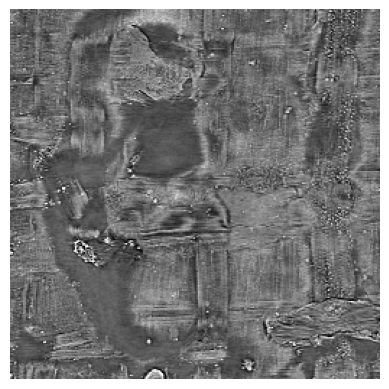

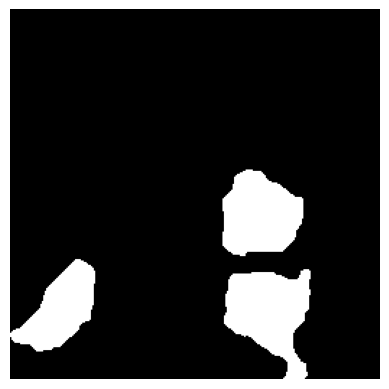

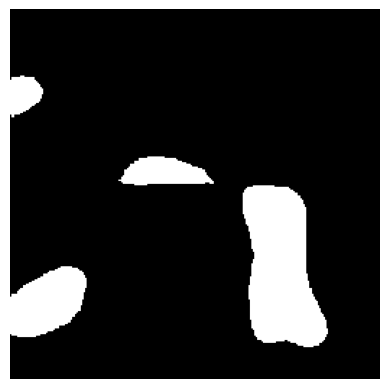

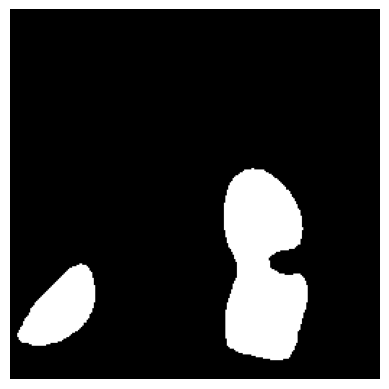

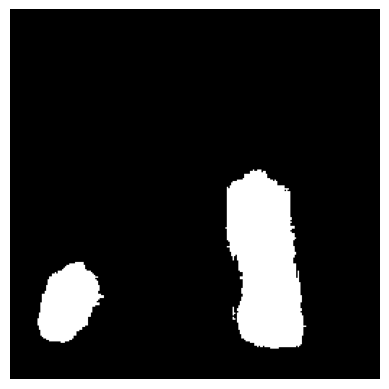

...

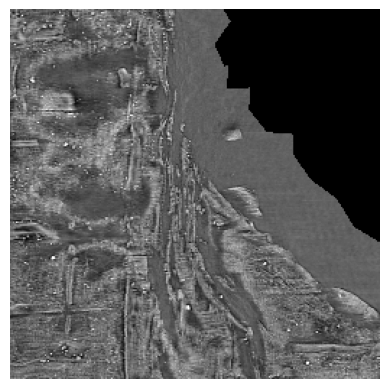

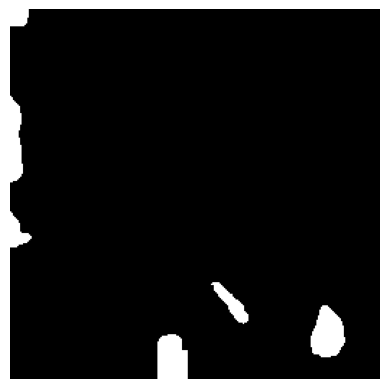

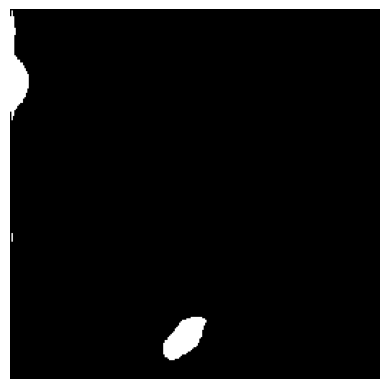

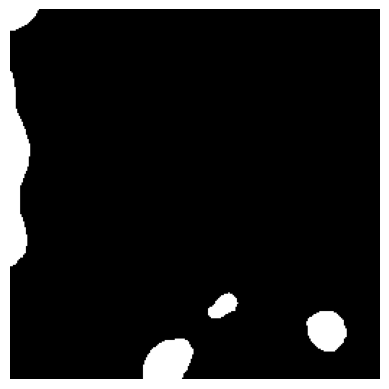

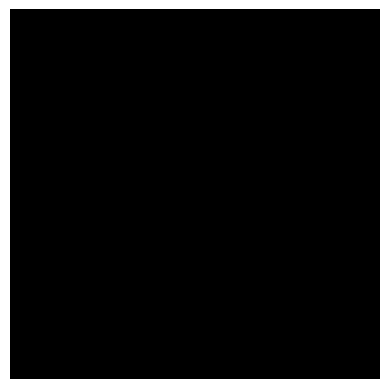

In [55]:
outputs_np = []
for result in results_test:
    # Convert the PyTorch tensor to a NumPy array
    outputs_np.append(result.cpu().numpy())

#Iterate over the outputs
for i in range(len(outputs_np)):

    if i%5 == 0:
        output = outputs_np[i][0][0]
    else:
        output = outputs_np[i][0][0] > 0.6

    # Display the output as an image
    plt.imshow(output, cmap='gray')  # Assuming grayscale images
    plt.axis('off')
    plt.show()

In [61]:
def calculate_iou(segmentations, ground_truths):
    """
    Calculate IoU for a list of binary segmentations and their ground truth images.

    Args:
        segmentations (list of numpy arrays): List of binary segmentation masks (0s and 1s).
        ground_truths (list of numpy arrays): List of ground truth binary masks (0s and 1s).

    Returns:
        iou_scores (list of floats): IoU scores for each pair of segmentation and ground truth.
        average_iou (float): Average IoU score.
    """
    iou_scores = []

    for seg, gt in zip(segmentations, ground_truths):
        seg = seg > 0.5
        intersection = np.logical_and(seg, gt)
        union = np.logical_or(seg, gt)

        iou = np.sum(intersection) / np.sum(union)

        if math.isnan(iou):
            iou = 0

        iou_scores.append(iou)

    average_iou = np.mean(iou_scores)

    return iou_scores, average_iou

In [152]:
iou_scores, average_iou = calculate_iou(pretrained_res, lbls)

# Print individual IoU scores and average IoU
for i, iou in enumerate(iou_scores):
    print(f"IoU for pair {i + 1}: {iou:.4f}")

print(f"Average IoU: {average_iou:.4f}")

IoU for pair 1: 0.5755
IoU for pair 2: 0.4029
IoU for pair 3: 0.5710
IoU for pair 4: 0.6201
IoU for pair 5: 0.4537
IoU for pair 6: 0.5657
IoU for pair 7: 0.5284
IoU for pair 8: 0.6465
IoU for pair 9: 0.6341
IoU for pair 10: 0.6108
IoU for pair 11: 0.6757
IoU for pair 12: 0.4737
IoU for pair 13: 0.5040
IoU for pair 14: 0.6567
IoU for pair 15: 0.5421
IoU for pair 16: 0.4271
IoU for pair 17: 0.5723
IoU for pair 18: 0.4518
IoU for pair 19: 0.2972
IoU for pair 20: 0.6499
IoU for pair 21: 0.4265
IoU for pair 22: 0.6961
IoU for pair 23: 0.6372
IoU for pair 24: 0.5615
IoU for pair 25: 0.7759
IoU for pair 26: 0.3698
IoU for pair 27: 0.5717
IoU for pair 28: 0.4682
IoU for pair 29: 0.6207
IoU for pair 30: 0.5377
IoU for pair 31: 0.7731
IoU for pair 32: 0.5193
IoU for pair 33: 0.5519
IoU for pair 34: 0.6162
IoU for pair 35: 0.5532
IoU for pair 36: 0.7160
IoU for pair 37: 0.7340
IoU for pair 38: 0.5556
IoU for pair 39: 0.4874
IoU for pair 40: 0.4293
IoU for pair 41: 0.6691
IoU for pair 42: 0.7219
I

In [31]:
def calculate_dice_coefficient(segmentations, ground_truths):
    """
    Calculate Dice coefficient for a list of binary segmentations and their ground truth images.

    Args:
        segmentations (list of numpy arrays): List of binary segmentation masks (0s and 1s).
        ground_truths (list of numpy arrays): List of ground truth binary masks (0s and 1s).

    Returns:
        dice_coefficients (list of floats): Dice coefficients for each pair of segmentation and ground truth.
        average_dice_coefficient (float): Average Dice coefficient.
    """
    dice_coefficients = []

    for seg, gt in zip(segmentations, ground_truths):
        seg = seg > 0.5
        intersection = np.logical_and(seg, gt)
        dice = (2.0 * np.sum(intersection)) / (np.sum(seg) + np.sum(gt))

        if math.isnan(dice):
            dice = 0

        dice_coefficients.append(dice)


    average_dice_coefficient = np.mean(dice_coefficients)

    return dice_coefficients, average_dice_coefficient

In [154]:
dice_scores, average_dice = calculate_dice_coefficient(pretrained_res, lbls)

# Print individual IoU scores and average IoU
for i, iou in enumerate(dice_scores):
    print(f"Dice for pair {i + 1}: {iou:.4f}")

print(f"Average Dice: {average_dice:.4f}")

Dice for pair 1: 0.7306
Dice for pair 2: 0.5744
Dice for pair 3: 0.7269
Dice for pair 4: 0.7655
Dice for pair 5: 0.6242
Dice for pair 6: 0.7226
Dice for pair 7: 0.6915
Dice for pair 8: 0.7853
Dice for pair 9: 0.7761
Dice for pair 10: 0.7584
Dice for pair 11: 0.8065
Dice for pair 12: 0.6428
Dice for pair 13: 0.6703
Dice for pair 14: 0.7928
Dice for pair 15: 0.7031
Dice for pair 16: 0.5985
Dice for pair 17: 0.7280
Dice for pair 18: 0.6224
Dice for pair 19: 0.4582
Dice for pair 20: 0.7878
Dice for pair 21: 0.5980
Dice for pair 22: 0.8208
Dice for pair 23: 0.7784
Dice for pair 24: 0.7192
Dice for pair 25: 0.8738
Dice for pair 26: 0.5399
Dice for pair 27: 0.7275
Dice for pair 28: 0.6378
Dice for pair 29: 0.7660
Dice for pair 30: 0.6994
Dice for pair 31: 0.8720
Dice for pair 32: 0.6836
Dice for pair 33: 0.7113
Dice for pair 34: 0.7625
Dice for pair 35: 0.7123
Dice for pair 36: 0.8345
Dice for pair 37: 0.8466
Dice for pair 38: 0.7144
Dice for pair 39: 0.6554
Dice for pair 40: 0.6007
Dice for 

In [155]:
def calculate_accuracy(segmentations, ground_truths):
    """
    Calculate accuracy for a list of binary segmentations and their ground truth images.

    Args:
        segmentations (list of numpy arrays): List of binary segmentation masks (0s and 1s).
        ground_truths (list of numpy arrays): List of ground truth binary masks (0s and 1s).

    Returns:
        accuracy_scores (list of floats): Accuracy scores for each pair of segmentation and ground truth.
        average_accuracy (float): Average accuracy score.
    """
    accuracy_scores = []

    for seg, gt in zip(segmentations, ground_truths):
        seg = seg > 0.5
        correct_pixels = np.sum(seg == gt)
        total_pixels = seg.size
        accuracy = correct_pixels / total_pixels
        accuracy_scores.append(accuracy)

    average_accuracy = np.mean(accuracy_scores)

    return accuracy_scores, average_accuracy

In [157]:
acc_scores, average_acc = calculate_accuracy(pretrained_res, lbls)

# Print individual IoU scores and average IoU
for i, iou in enumerate(acc_scores):
    print(f"Acc for pair {i + 1}: {iou:.4f}")

print(f"Average Acc: {average_acc:.4f}")

Acc for pair 1: 0.9360
Acc for pair 2: 0.8916
Acc for pair 3: 0.8958
Acc for pair 4: 0.8769
Acc for pair 5: 0.8168
Acc for pair 6: 0.9416
Acc for pair 7: 0.9093
Acc for pair 8: 0.9201
Acc for pair 9: 0.8943
Acc for pair 10: 0.9047
Acc for pair 11: 0.9019
Acc for pair 12: 0.8376
Acc for pair 13: 0.9234
Acc for pair 14: 0.8862
Acc for pair 15: 0.8846
Acc for pair 16: 0.8296
Acc for pair 17: 0.8994
Acc for pair 18: 0.9153
Acc for pair 19: 0.9277
Acc for pair 20: 0.8795
Acc for pair 21: 0.8916
Acc for pair 22: 0.9070
Acc for pair 23: 0.9339
Acc for pair 24: 0.9114
Acc for pair 25: 0.9340
Acc for pair 26: 0.9748
Acc for pair 27: 0.8694
Acc for pair 28: 0.8770
Acc for pair 29: 0.8495
Acc for pair 30: 0.9118
Acc for pair 31: 0.9433
Acc for pair 32: 0.9205
Acc for pair 33: 0.8626
Acc for pair 34: 0.8791
Acc for pair 35: 0.8378
Acc for pair 36: 0.9712
Acc for pair 37: 0.9912
Acc for pair 38: 0.8676
Acc for pair 39: 0.8382
Acc for pair 40: 0.8372
Acc for pair 41: 0.8928
Acc for pair 42: 0.9482
A

In [39]:
def calculate_precision(segmentations, ground_truths):
    """
    Calculate precision for a list of binary segmentations and their ground truth images.

    Args:
        segmentations (list of numpy arrays): List of binary segmentation masks (0s and 1s).
        ground_truths (list of numpy arrays): List of ground truth binary masks (0s and 1s).

    Returns:
        precision_scores (list of floats): Precision scores for each pair of segmentation and ground truth.
        average_precision (float): Average precision score.
    """
    precision_scores = []

    for seg, gt in zip(segmentations, ground_truths):
        seg = seg > 0.5
        true_positives = np.sum(np.logical_and(seg == 1, gt == 1))
        false_positives = np.sum(np.logical_and(seg == 1, gt == 0))
        precision = true_positives / (true_positives + false_positives)

        if math.isnan(precision):
            precision = 0

        precision_scores.append(precision)

    average_precision = np.mean(precision_scores)

    return precision_scores, average_precision

In [159]:
prec_scores, average_prec = calculate_precision(pretrained_res, lbls)

# Print individual IoU scores and average IoU
for i, iou in enumerate(prec_scores):
    print(f"Prec for pair {i + 1}: {iou:.4f}")

print(f"Average Acc: {average_prec:.4f}")

Prec for pair 1: 0.6957
Prec for pair 2: 0.5797
Prec for pair 3: 0.8044
Prec for pair 4: 0.7722
Prec for pair 5: 0.6393
Prec for pair 6: 0.7048
Prec for pair 7: 0.6711
Prec for pair 8: 0.8218
Prec for pair 9: 0.7928
Prec for pair 10: 0.6803
Prec for pair 11: 0.7739
Prec for pair 12: 0.6238
Prec for pair 13: 0.6831
Prec for pair 14: 0.7917
Prec for pair 15: 0.7881
Prec for pair 16: 0.5657
Prec for pair 17: 0.7528
Prec for pair 18: 0.7667
Prec for pair 19: 0.6206
Prec for pair 20: 0.7830
Prec for pair 21: 0.5555
Prec for pair 22: 0.7636
Prec for pair 23: 0.7193
Prec for pair 24: 0.7819
Prec for pair 25: 0.8504
Prec for pair 26: 0.6348
Prec for pair 27: 0.7094
Prec for pair 28: 0.8330
Prec for pair 29: 0.7984
Prec for pair 30: 0.7719
Prec for pair 31: 0.8869
Prec for pair 32: 0.6808
Prec for pair 33: 0.6863
Prec for pair 34: 0.7581
Prec for pair 35: 0.6936
Prec for pair 36: 0.7696
Prec for pair 37: 0.7610
Prec for pair 38: 0.7592
Prec for pair 39: 0.6914
Prec for pair 40: 0.5748
Prec for 

In [45]:
def calculate_recall(segmentations, ground_truths):
    """
    Calculate recall for a list of binary segmentations and their ground truth images.

    Args:
        segmentations (list of numpy arrays): List of binary segmentation masks (0s and 1s).
        ground_truths (list of numpy arrays): List of ground truth binary masks (0s and 1s).

    Returns:
        recall_scores (list of floats): Recall scores for each pair of segmentation and ground truth.
        average_recall (float): Average recall score.
    """
    recall_scores = []

    for seg, gt in zip(segmentations, ground_truths):
        seg = seg > 0.5
        true_positives = np.sum(np.logical_and(seg == 1, gt == 1))
        false_negatives = np.sum(np.logical_and(seg == 0, gt == 1))
        recall = true_positives / (true_positives + false_negatives)

        if math.isnan(recall):
            recall = 0

        recall_scores.append(recall)

    average_recall = np.mean(recall_scores)

    return recall_scores, average_recall

In [161]:
prec_scores, average_prec = calculate_recall(pretrained_res, lbls)

# Print individual IoU scores and average IoU
for i, iou in enumerate(prec_scores):
    print(f"Prec for pair {i + 1}: {iou:.4f}")

print(f"Average Acc: {average_prec:.4f}")

Prec for pair 1: 0.7691
Prec for pair 2: 0.5691
Prec for pair 3: 0.6630
Prec for pair 4: 0.7589
Prec for pair 5: 0.6098
Prec for pair 6: 0.7413
Prec for pair 7: 0.7131
Prec for pair 8: 0.7519
Prec for pair 9: 0.7600
Prec for pair 10: 0.8566
Prec for pair 11: 0.8419
Prec for pair 12: 0.6630
Prec for pair 13: 0.6579
Prec for pair 14: 0.7939
Prec for pair 15: 0.6346
Prec for pair 16: 0.6353
Prec for pair 17: 0.7048
Prec for pair 18: 0.5238
Prec for pair 19: 0.3631
Prec for pair 20: 0.7927
Prec for pair 21: 0.6475
Prec for pair 22: 0.8874
Prec for pair 23: 0.8482
Prec for pair 24: 0.6659
Prec for pair 25: 0.8985
Prec for pair 26: 0.4697
Prec for pair 27: 0.7466
Prec for pair 28: 0.5167
Prec for pair 29: 0.7361
Prec for pair 30: 0.6393
Prec for pair 31: 0.8576
Prec for pair 32: 0.6865
Prec for pair 33: 0.7381
Prec for pair 34: 0.7670
Prec for pair 35: 0.7321
Prec for pair 36: 0.9115
Prec for pair 37: 0.9540
Prec for pair 38: 0.6745
Prec for pair 39: 0.6229
Prec for pair 40: 0.6290
Prec for 

In [50]:
def calculate_f1_score(segmentations, ground_truths):
    """
    Calculate F1 score for a list of binary segmentations and their ground truth images.

    Args:
        segmentations (list of numpy arrays): List of binary segmentation masks (0s and 1s).
        ground_truths (list of numpy arrays): List of ground truth binary masks (0s and 1s).

    Returns:
        f1_scores (list of floats): F1 scores for each pair of segmentation and ground truth.
        average_f1 (float): Average F1 score.
    """
    f1_scores = []

    for seg, gt in zip(segmentations, ground_truths):
        seg = seg > 0.5
        true_positives = np.sum(np.logical_and(seg == 1, gt == 1))
        false_positives = np.sum(np.logical_and(seg == 1, gt == 0))
        false_negatives = np.sum(np.logical_and(seg == 0, gt == 1))
        precision = true_positives / (true_positives + false_positives)
        recall = true_positives / (true_positives + false_negatives)
        f1 = 2 * (precision * recall) / (precision + recall)

        if math.isnan(f1):
            f1 = 0

        f1_scores.append(f1)

    average_f1 = np.mean(f1_scores)

    return f1_scores, average_f1

In [163]:
prec_scores, average_prec = calculate_f1_score(pretrained_res, lbls)

# Print individual IoU scores and average IoU
for i, iou in enumerate(prec_scores):
    print(f"Prec for pair {i + 1}: {iou:.4f}")

print(f"Average Acc: {average_prec:.4f}")

Prec for pair 1: 0.7306
Prec for pair 2: 0.5744
Prec for pair 3: 0.7269
Prec for pair 4: 0.7655
Prec for pair 5: 0.6242
Prec for pair 6: 0.7226
Prec for pair 7: 0.6915
Prec for pair 8: 0.7853
Prec for pair 9: 0.7761
Prec for pair 10: 0.7584
Prec for pair 11: 0.8065
Prec for pair 12: 0.6428
Prec for pair 13: 0.6703
Prec for pair 14: 0.7928
Prec for pair 15: 0.7031
Prec for pair 16: 0.5985
Prec for pair 17: 0.7280
Prec for pair 18: 0.6224
Prec for pair 19: 0.4582
Prec for pair 20: 0.7878
Prec for pair 21: 0.5980
Prec for pair 22: 0.8208
Prec for pair 23: 0.7784
Prec for pair 24: 0.7192
Prec for pair 25: 0.8738
Prec for pair 26: 0.5399
Prec for pair 27: 0.7275
Prec for pair 28: 0.6378
Prec for pair 29: 0.7660
Prec for pair 30: 0.6994
Prec for pair 31: 0.8720
Prec for pair 32: 0.6836
Prec for pair 33: 0.7113
Prec for pair 34: 0.7625
Prec for pair 35: 0.7123
Prec for pair 36: 0.8345
Prec for pair 37: 0.8466
Prec for pair 38: 0.7144
Prec for pair 39: 0.6554
Prec for pair 40: 0.6007
Prec for 

In [54]:
def calculate_f05_score(segmentations, ground_truths):
    """
    Calculate F0.5 score for a list of binary segmentations and their ground truth images.

    Args:
        segmentations (list of numpy arrays): List of binary segmentation masks (0s and 1s).
        ground_truths (list of numpy arrays): List of ground truth binary masks (0s and 1s).

    Returns:
        f05_scores (list of floats): F0.5 scores for each pair of segmentation and ground truth.
        average_f05 (float): Average F0.5 score.
    """
    f05_scores = []

    for seg, gt in zip(segmentations, ground_truths):
        seg = seg > 0.5
        true_positives = np.sum(np.logical_and(seg == 1, gt == 1))
        false_positives = np.sum(np.logical_and(seg == 1, gt == 0))
        false_negatives = np.sum(np.logical_and(seg == 0, gt == 1))
        precision = true_positives / (true_positives + false_positives)
        recall = true_positives / (true_positives + false_negatives)

        beta = 0.5  # Adjust this value to change the weighting between precision and recall
        f05 = ((1 + beta**2) * precision * recall) / ((beta**2 * precision) + recall)

        if math.isnan(f05):
            f05 = 0

        f05_scores.append(f05)

    average_f05 = np.mean(f05_scores)

    return f05_scores, average_f05

In [166]:
prec_scores, average_prec = calculate_f05_score(pretrained_res, lbls)

# Print individual IoU scores and average IoU
for i, iou in enumerate(prec_scores):
    print(f"Prec for pair {i + 1}: {iou:.4f}")

print(f"Average Acc: {average_prec:.4f}")

Prec for pair 1: 0.7092
Prec for pair 2: 0.5776
Prec for pair 3: 0.7715
Prec for pair 4: 0.7695
Prec for pair 5: 0.6332
Prec for pair 6: 0.7118
Prec for pair 7: 0.6791
Prec for pair 8: 0.8068
Prec for pair 9: 0.7860
Prec for pair 10: 0.7095
Prec for pair 11: 0.7866
Prec for pair 12: 0.6313
Prec for pair 13: 0.6779
Prec for pair 14: 0.7921
Prec for pair 15: 0.7517
Prec for pair 16: 0.5784
Prec for pair 17: 0.7427
Prec for pair 18: 0.7016
Prec for pair 19: 0.5435
Prec for pair 20: 0.7849
Prec for pair 21: 0.5718
Prec for pair 22: 0.7855
Prec for pair 23: 0.7418
Prec for pair 24: 0.7555
Prec for pair 25: 0.8596
Prec for pair 26: 0.5931
Prec for pair 27: 0.7165
Prec for pair 28: 0.7421
Prec for pair 29: 0.7851
Prec for pair 30: 0.7411
Prec for pair 31: 0.8809
Prec for pair 32: 0.6819
Prec for pair 33: 0.6961
Prec for pair 34: 0.7598
Prec for pair 35: 0.7010
Prec for pair 36: 0.7943
Prec for pair 37: 0.7931
Prec for pair 38: 0.7406
Prec for pair 39: 0.6766
Prec for pair 40: 0.5849
Prec for 

In [27]:
test_data = load_dataset(VESUVIUS_DATA_PATH, dataset = 'test')

Fragment: a Loaded: crop_7.png
Fragment: a Loaded: crop_8.png
Fragment: a Loaded: crop_9.png
Fragment: a Loaded: crop_10.png
Fragment: a Loaded: crop_11.png
Fragment: a Loaded: crop_12.png
Fragment: a Loaded: crop_13.png
Fragment: a Loaded: crop_19.png
Fragment: a Loaded: crop_20.png
Fragment: a Loaded: crop_21.png
Fragment: a Loaded: crop_22.png
Fragment: a Loaded: crop_23.png
Fragment: a Loaded: crop_24.png
Fragment: a Loaded: crop_25.png
Fragment: a Loaded: crop_26.png
Fragment: a Loaded: crop_27.png
Fragment: a Loaded: crop_32.png
Fragment: a Loaded: crop_33.png
Fragment: a Loaded: crop_34.png
Fragment: a Loaded: crop_35.png
Fragment: a Loaded: crop_36.png
Fragment: a Loaded: crop_37.png
Fragment: a Loaded: crop_38.png
Fragment: a Loaded: crop_39.png
Fragment: a Loaded: crop_40.png
Fragment: a Loaded: crop_41.png
Fragment: a Loaded: crop_45.png
Fragment: a Loaded: crop_46.png
Fragment: a Loaded: crop_47.png
Fragment: a Loaded: crop_48.png
Fragment: a Loaded: crop_49.png
Fragment: a

In [28]:
test_dataset = test_data

for i in range(len(test_dataset)):
    test_dataset[i][0] = test_dataset[i][0][:,:,:,:,0]

for i in range(len(test_dataset)):
    test_dataset[i][0] = test_dataset[i][0].reshape(test_dataset[i][0].shape[0],test_dataset[i][0].shape[1],crop_size,crop_size)

In [46]:
frag_test_data=test_dataset[1][0] #[fragment][volume/label]
frag_test_data=frag_test_data[:,18:18+layer_depth,:,:,]
frag_test_data.shape

(106, 32, 256, 256)

In [47]:
test_tensor = torch.from_numpy(frag_test_data)
test_tensor = test_tensor.to(torch.float32)

In [48]:
test_loader = DataLoader(test_tensor, batch_size=1)

In [49]:
results_test = []

with torch.no_grad():
    for batch in test_loader:
        # Move the batch to the GPU if available
        img = batch
        batch = img.to(device) if torch.cuda.is_available() else batch

        # Perform inference
        outputs = model(batch)
        outputs_pretrained = model_pretrained(batch)
        outputs_freezed = model_freezed(batch)


        results_test.append(img)
        #results_test.append(lbl)
        results_test.append(outputs)
        results_test.append(outputs_pretrained)
        results_test.append(outputs_freezed)

        #lbls.append(lbl.cpu().detach().numpy())
        #base_res.append(outputs.cpu().detach().numpy())
        #pretrained_res.append(outputs_pretrained.cpu().detach().numpy())
        #freezed_res.append(outputs_freezed.cpu().detach().numpy())

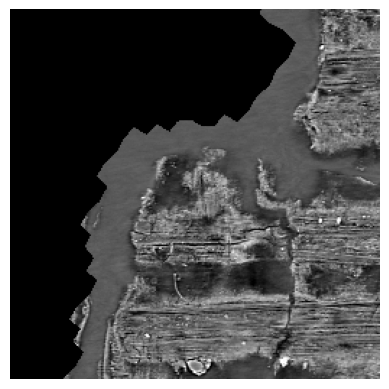

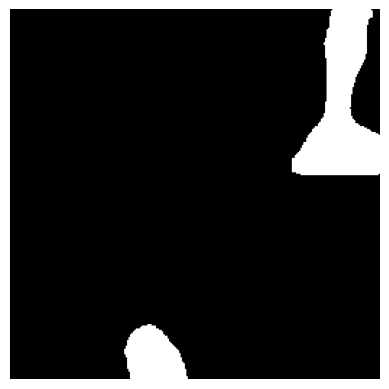

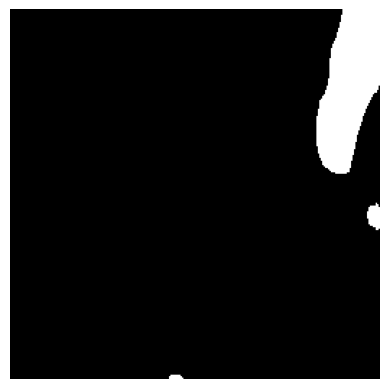

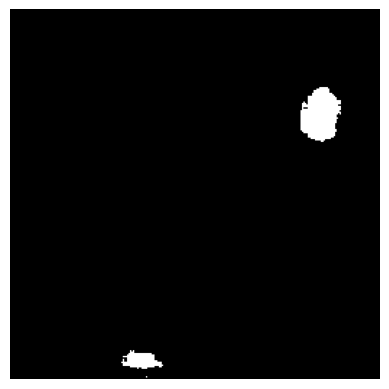

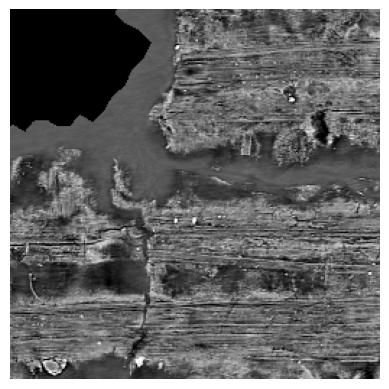

...

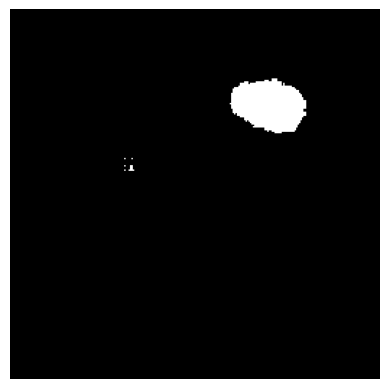

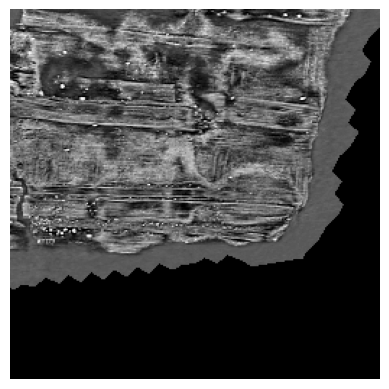

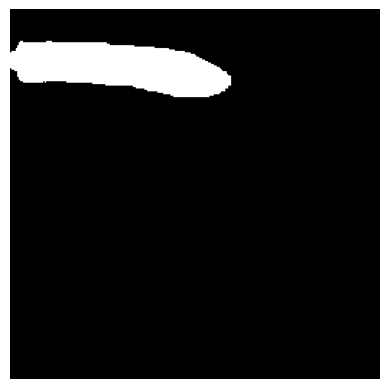

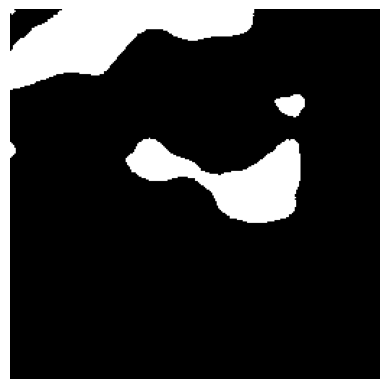

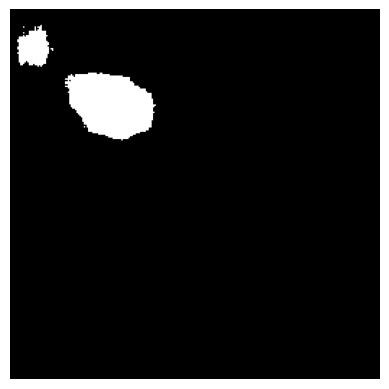

In [50]:
outputs_np = []
for result in results_test:
    # Convert the PyTorch tensor to a NumPy array
    outputs_np.append(result.cpu().numpy())

#Iterate over the outputs
for i in range(len(outputs_np)):

    if i%4 == 0:
        output = outputs_np[i][0][0]
    else:
        output = outputs_np[i][0][0] > 0.5

    # Display the output as an image
    plt.imshow(output, cmap='gray')  # Assuming grayscale images
    plt.axis('off')
    plt.show()